*Note: 10x Genomics does not provide support for community-developed tools and makes no guarantees regarding their function or performance. Please contact tool developers with any questions.*

How to use this Google Colab


- Select Python as the programming language: Click “Runtime”, then ensure “Runtime type” is set to “Python”. We recommend selecting “v2-8 TPU” for this Google Colab tutorial. There could be TPU usage [limit](https://research.google.com/colaboratory/faq.html#usage-limits).
- Click the “Connect” button on the top-right corner. Now, you are ready to run the tutorial.
- You can run the analysis using the data we provided in the code. Alternatively, you can also load your own data by following the instructions at the beginning of each section.


# **1. Install packages and download the data**

## 1.1 Install and import the Python packages

In [ ]:
!uv pip install spatialdata[extra]==0.4.0 scanpy==1.11.2 scikit-misc==0.5.1 squidpy==1.6.5 harmonypy==0.0.10 geosketch==1.3 igraph==0.11.8 pyarrow==21.0.0

Streaming output truncated to the last 5000 lines.
pyqt5-sip  ------------------------------ 30.91 KiB/269.92 KiB
⠹ Preparing packages... (0/116)
sphinxcontrib-serializinghtml ------------------------------ 78.89 KiB/89.91 KiB
npe2       ------------------------------ 46.92 KiB/91.44 KiB
qtpy       ------------------------------ 78.92 KiB/92.82 KiB
sphinxcontrib-htmlhelp ------------------------------ 78.90 KiB/96.39 KiB
superqt    ------------------------------ 32.00 KiB/98.22 KiB
napari-spatialdata ------------------------------ 32.00 KiB/100.21 KiB
snowballstemmer ------------------------------ 64.97 KiB/100.85 KiB
param      ------------------------------ 32.00 KiB/116.26 KiB
sphinxcontrib-applehelp ------------------------------ 78.89 KiB/116.50 KiB
qtconsole  ------------------------------ 37.34 KiB/122.10 KiB
magicgui   ------------------------------ 78.91 KiB/125.04 KiB
squidpy    ------------------------------ 46.91 KiB/157.51 KiB
anndata    ------------------------------ 46.9

In [ ]:
# Import the python packages. Rerun this code again if there is you encounter an error on xarray_schema.
import scanpy as sc
import pandas as pd
import numpy as np
import h5py
import anndata as ad
import matplotlib.pyplot as plt
import warnings
import os
import squidpy as sq
import spatialdata as sd
import spatialdata_io as sio
import spatialdata_plot

%load_ext autoreload
%autoreload 2

warnings.filterwarnings("ignore")

/usr/local/lib/python3.11/dist-packages/dask/dataframe/__init__.py:31: FutureWarning: The legacy Dask DataFrame implementation is deprecated and will be removed in a future version. Set the configuration option `dataframe.query-planning` to `True` or None to enable the new Dask Dataframe implementation and silence this warning.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/anndata/__init__.py:44: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  return module_get_attr_redirect(attr_name, deprecated_mapping=_DEPRECATED)
/usr/local/lib/python3.11/dist-packages/anndata/__init__.py:44: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  return module_get_attr_redirect(attr_name, deprecated_mapping=_DEPRECATED)


## 1.2 Download and preprocess the Xenium data (optional)

### 1.2.1 Download data and convert to zarr format

This step may take some time, as the Xenium Prime Breast Cancer output bundle is 41GB in size. For convenience, we've included a smaller Zarr file in the next section. If you'd like to generate this smaller Zarr file yourself, simply uncomment and run the code provided below.

**Important note**: The Zarr format used by spatialdata differs from the format used in the Xenium bundle. To take full advantage of spatialdata’s optimizations, you must convert the Xenium bundle Zarr to the spatialdata Zarr format. The commented code below demonstrates how to perform this conversion. For more details, please refer to [Xenium spatialdata tutorial](https://spatialdata.scverse.org/en/latest/tutorials/notebooks/notebooks/examples/technology_xenium.html#loading-the-data).

In [ ]:
# !wget https://s3-us-west-2.amazonaws.com/10x.files/samples/xenium/3.0.0/Xenium_Prime_Breast_Cancer_FFPE/Xenium_Prime_Breast_Cancer_FFPE_outs.zip
# !unzip Xenium_Prime_Breast_Cancer_FFPE_outs.zip -d Xenium_Prime_Breast_Cancer_FFPE_outs

In [ ]:
# sdata = sio.xenium("Xenium_Prime_Breast_Cancer_FFPE_outs/")
# # We delete the image as it takes up a lot of memory and we do not use for this analysis guide
# del sdata['morphology_focus']
# sdata.write("breast.zarr")

In [ ]:
# Download and delete zip folder
!wget https://cf.10xgenomics.com/supp/xenium/analysis-workshop/breast.zarr.zip
!unzip breast.zarr.zip
!rm breast.zarr.zip


# **2. Xenium data visualization and analysis (for one sample)**

## Section 2.1 Introduction to SpatialData
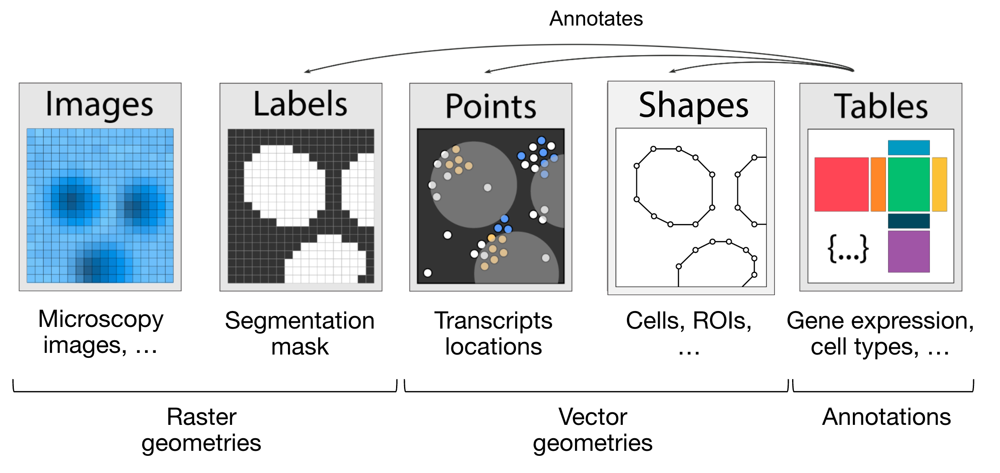

SpatialData is an extremely flexible tool that allows us to load Xenium data. There are a total of 5 main objects in SpatialData, which each correspond to

**Images** - These are the Xenium images, e.g., the morphology images or H&E/IF images. Examples are `morphology_focus_0000.ome.tif` images in the Xenium folders or corresponding H&E/IF images. \
**Labels** - Segmentation masks provided by Xenium. The Xenium bundle provides both the cell labels and nucleus labels. \
**Points** - These are used to represent the transcripts (`transcripts.parquet`) located in space. \
**Shapes** - Cell segmentation results from XOA. \
**Tables** - Gene expression of the single cell dataset. This is the count matrix, which is the ncells x nfeatures matrix. This object is an anndata object and can be analysed similar to a single cell data.

## Section 2.2 Loading objects for Xenium data




In [ ]:
sdata = sd.read_zarr("breast.zarr/")
sdata

SpatialData object, with associated Zarr store: /content/breast.zarr
├── Labels
│     ├── 'cell_labels': DataTree[yx] (74945, 51265), (37472, 25632), (18736, 12816), (9368, 6408), (4684, 3204)
│     └── 'nucleus_labels': DataTree[yx] (74945, 51265), (37472, 25632), (18736, 12816), (9368, 6408), (4684, 3204)
├── Points
│     └── 'transcripts': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (699110, 1) (2D shapes)
│     ├── 'cell_circles': GeoDataFrame shape: (699110, 2) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (692184, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (699110, 5101)
with coordinate systems:
    ▸ 'global', with elements:
        cell_labels (Labels), nucleus_labels (Labels), transcripts (Points), cell_boundaries (Shapes), cell_circles (Shapes), nucleus_boundaries (Shapes)

## Section 2.3 Transcript and cell plotting functions for Xenium data

The "cell_boundaries" shapes point us to the spatial locations and shape of the cells, while the "table" object points us to the gene expression. We need to link them together with the function `set_table_annotates_spatialelement`. For cells, the plotting function is `render_shapes`, while for transcripts, the function is `render_points`. For more detailed, please refer to the official [spatialdata plotting documentation](https://spatialdata.scverse.org/projects/plot/en/stable/plotting.html).

INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                
INFO     Using the datashader reduction "mean". "max" will give an output very close to the matplotlib result.     


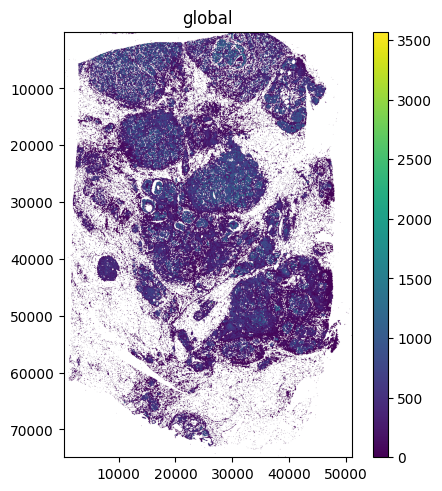

In [ ]:
sdata.tables["table"].obs["region"] = "cell_boundaries"
sdata.set_table_annotates_spatialelement("table", region="cell_boundaries")

# The x and y axis are pixel coordinates
sdata.pl.render_shapes("cell_boundaries", color="total_counts").pl.show()

Alternatively, spatialadata allows us to plot two or more transcripts on the same tissue.

INFO     input has more than 103 categories. Uniform 'grey' color will be used for all categories.                 
INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                


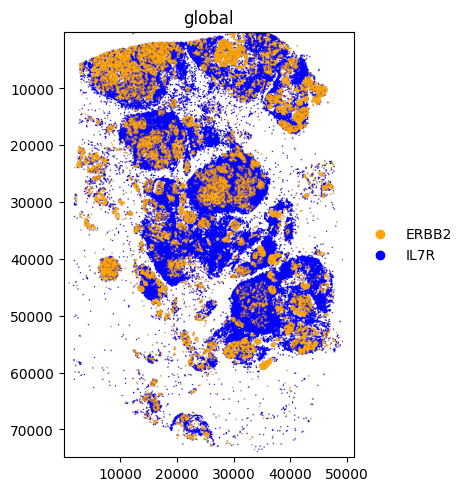

In [ ]:
sdata.pl.render_points(
    "transcripts",
    color="feature_name",
    groups=["ERBB2", "IL7R"],
    palette=["orange", "blue"],
).pl.show()



## Section 2.4 Select sub-region of interest

There are two ways to select sub-regions of interest


1.   By coordinates
2.   By cell IDs



### 2.4.1 Select sub-region by coordinates

First of all, select a sub-region of interest and download its coordinates

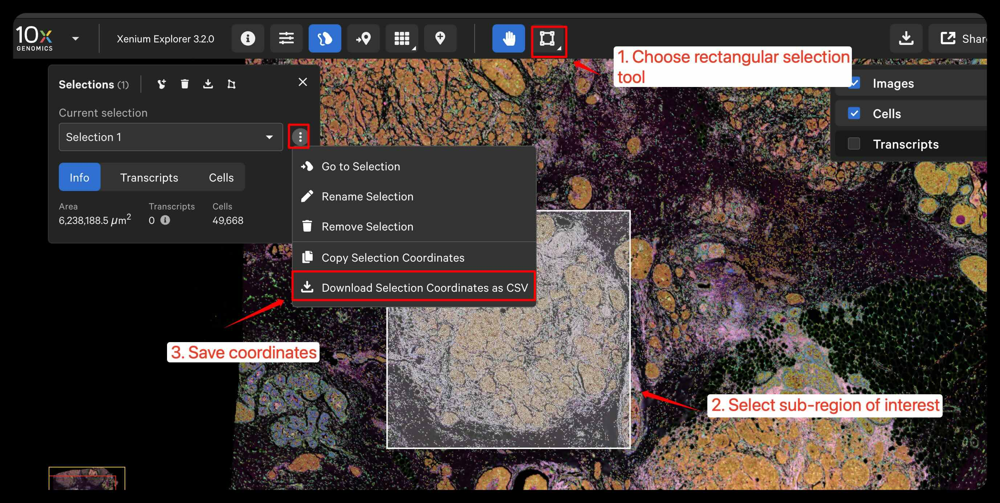

Here is an example of the coordinate CSV file obtained from Xenium Explorer.

```
#Selection name: Selection 1
#Area (µm^2): 6238188.5
X,Y
2082.2669778917857,2883.948207577963
4605.827306527083,2883.948207577963
4605.827306527083,5355.927347229994
2082.2669778917857,5355.927347229994
2082.2669778917857,2883.948207577963
```
Note that the coordinate unit is in microns, while in SpatialData the units are in pixels. Therefore, we need to scale the data from micron to pixels to obtain the coordinates in SpatialData (https://kb.10xgenomics.com/hc/en-us/articles/11636252598925-What-are-the-Xenium-image-scale-factors).


In [ ]:
from spatialdata import bounding_box_query

scale = 1 / 0.2125
min_x = 2082.2669778917857 * scale
min_y = 2883.948207577963 * scale
max_x = 4605.827306527083 * scale
max_y = 5355.927347229994 * scale


def crop0(x, min_x, min_y, max_x, max_y):
    return bounding_box_query(
        x,
        min_coordinate=[min_x, min_y],
        max_coordinate=[max_x, max_y],
        axes=("x", "y"),
        target_coordinate_system="global",
    )


cropped_sdata = crop0(sdata, min_x, min_y, max_x, max_y)

 Alternatively, you can directly use the `spatialdata_io.xenium_explorer_selection` function to read in the CSV directly, which does the scaling for you.

In [ ]:
!wget https://cf.10xgenomics.com/supp/xenium/analysis-workshop/Selection_1_coordinates.csv

--2025-07-22 09:36:00--  https://cf.10xgenomics.com/supp/xenium/analysis-workshop/Selection_1_coordinates.csv
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.1.173, 104.18.0.173, 2606:4700::6812:1ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.1.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 249 [text/csv]
Saving to: ‘Selection_1_coordinates.csv’

Selection_1_coordin 100%[===================>]     249  --.-KB/s    in 0s      

2025-07-22 09:36:00 (253 MB/s) - ‘Selection_1_coordinates.csv’ saved [249/249]



In [ ]:
%%time
from spatialdata import polygon_query


def crop0(x, polygon):
    return polygon_query(
        x,
        polygon,
        target_coordinate_system="global",
    )


polygon = sio.xenium_explorer_selection("Selection_1_coordinates.csv")
cropped_sdata = crop0(sdata, polygon)

CPU times: user 4min 27s, sys: 1min 6s, total: 5min 34s
Wall time: 4min 44s


INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                
INFO     Using the datashader reduction "mean". "max" will give an output very close to the matplotlib result.     


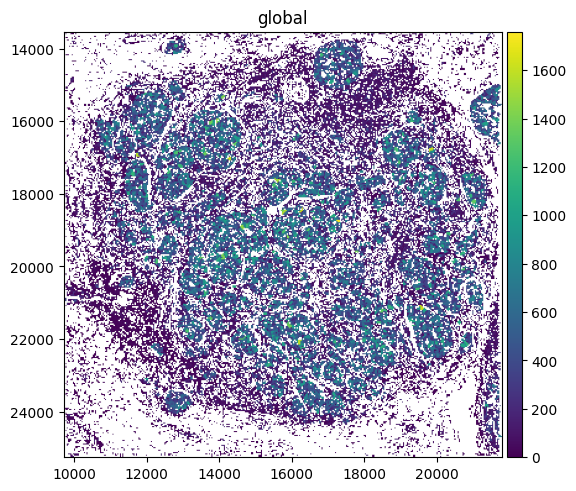

In [ ]:
# Plotting the subsetted region
cropped_sdata.tables["table"].obs["region"] = "cell_boundaries"
cropped_sdata.set_table_annotates_spatialelement("table", region="cell_boundaries")

cropped_sdata.pl.render_shapes("cell_boundaries", color="total_counts").pl.show()

### 2.4.2 Select sub-region by cell IDs

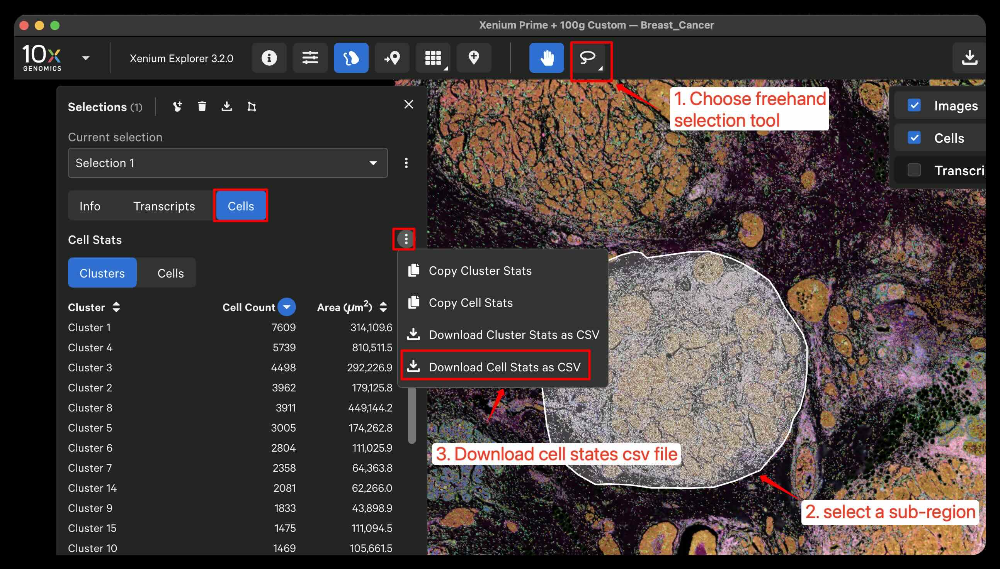

Upload the downloaded cell state CSV file to this colab. Here an example - "Selection_1_cells_stats.csv"

In [ ]:
!wget https://cf.10xgenomics.com/supp/xenium/analysis-workshop/one-sample-analysis.tar.gz
!tar -xzvf ./one-sample-analysis.tar.gz

--2025-07-22 09:40:50--  https://cf.10xgenomics.com/supp/xenium/analysis-workshop/one-sample-analysis.tar.gz
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1917425125 (1.8G) [application/x-tar]
Saving to: ‘one-sample-analysis.tar.gz’

one-sample-analysis 100%[===================>]   1.79G   193MB/s    in 9.3s    

2025-07-22 09:40:59 (196 MB/s) - ‘one-sample-analysis.tar.gz’ saved [1917425125/1917425125]

./one-sample-analysis/
./one-sample-analysis/Xenium_Prime_Breast_Cancer_FFPE_outs/
./one-sample-analysis/Xenium_Prime_Breast_Cancer_FFPE_outs/cell_feature_matrix/
./one-sample-analysis/Xenium_Prime_Breast_Cancer_FFPE_outs/cell_feature_matrix/matrix.mtx.gz
./one-sample-analysis/Xenium_Prime_Breast_Cancer_FFPE_outs/cell_feature_matrix/features.tsv.gz
./one-sample-analysis/Xenium_Prime_Breast

In [ ]:
select_cells = pd.read_csv(
    "./one-sample-analysis/Selection_1_cells_stats.csv", skiprows=2
)
select_cells.head()

,Cell ID,Cluster,Transcripts,Area (µm^2)
0,eaedgfpo-1,Cluster 2,0,35.69
1,dchjbpll-1,Cluster 11,0,158.68
2,dbndddjb-1,Cluster 5,0,26.42
3,iepagjon-1,Cluster 12,0,23.59
4,odblddca-1,Cluster 25,0,23.06


In [ ]:
subset_sdata = sd.match_sdata_to_table(
    sdata,
    table=sdata["table"][sdata["table"].obs["cell_id"].isin(select_cells["Cell ID"])],
    table_name="table",
    how="right",
)

INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                
INFO     Using the datashader reduction "mean". "max" will give an output very close to the matplotlib result.     


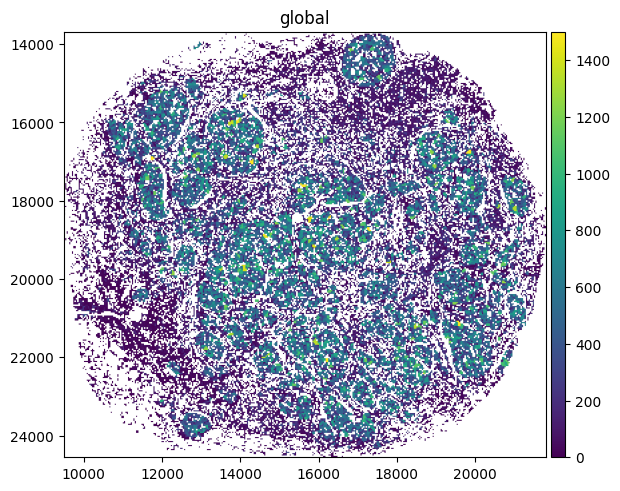

In [ ]:
# Clipping the data for the plotting to be more obvious.
import matplotlib.colors as mpc

norm = mpc.Normalize(vmin=0, vmax=1500, clip=True)

subset_sdata.pl.render_shapes(
    "cell_boundaries", color="total_counts", norm=norm
).pl.show()

## Section 2.5 Downstream Xenium data analysis of count matrix (sdata['table'])

### Section 2.5.1 Short introduction to anndata

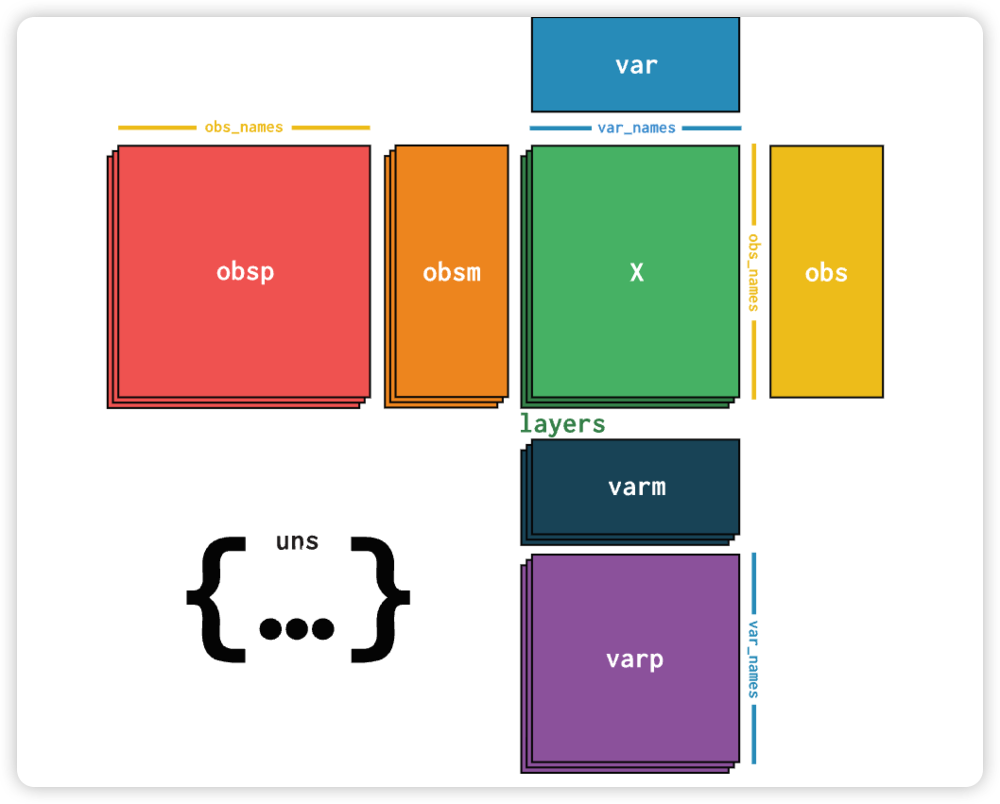

The sdata['table'] is a regular anndata object, which is commonly used in single cell anlaysis. AnnData is specifically designed for matrix-like data. We have *n* observations (cells), each of which can be represented as
d-dimensional vectors (genes).

**Core Data**

| Attribute | Type                  | Description                         | Example                          |
|-----------|-----------------------|-------------------------------------|----------------------------------|
| `X`       | `np.ndarray` / `sp.spmatrix` | Main data matrix (n × d), used by most scanpy functions by default   | `Raw counts`, `log-normalized`        |
| `layers`  | `dict[array]`         | Alternative data matrices            | `counts`, `lognorm`, `imputed`      |

**Cell-Level attributes/metadata(Observations)**

| Attribute | Type                  | Description                         | Example                          |
|-----------|-----------------------|-------------------------------------|----------------------------------|
| `obs`     | `pd.DataFrame`        | Per-cell metadata                   | `cell_type`, `batch`             |
| `obsm`    | `dict[np.ndarray]`    | Cell embeddings or coords (n × d)   | `X_umap`, `X_pca`, `spatial`     |
| `obsp`    | `dict[sp.spmatrix]`   | Cell-cell graphs (n × n)            | `connectivities`, `distances`    |

**Gene-Level attributes/metadata(Variables)**

| Attribute | Type                  | Description                         | Example                          |
|-----------|-----------------------|-------------------------------------|----------------------------------|
| `var`     | `pd.DataFrame`        | Per-gene metadata                   | `gene_name`, `highly_variable`   |
| `varm`    | `dict[np.ndarray]`    | Gene-level arrays (d × k)           | `PCs`, `loadings`                |
| `varp`    | `dict[sp.spmatrix]`   | Gene-gene graphs (d × d)            | `gene_corr`, `coexpression_net`  |

**Other Components**

| Attribute | Type                  | Description                         | Example                          |
|-----------|-----------------------|-------------------------------------|----------------------------------|
| `uns`     | `dict`                | Unstructured annotations / metadata | `neighbors`, `rank_genes_groups`  |


### Section 2.5.2 Standard data preprocessing

The first step is QC. We want to remove cells with low transcript counts. Here we plot the distribution of transcript counts per cell in a histogram to determine the transcript count cutoff to remove cells with low transcript counts. The determination of lower cutoff can be subjective. There is no gold-standard rule.  

 We shallow copy with the step `adata = sdata['table]`. Any changes made in adata will be reflected in sdata['table]. To make a separate adata object, run `adata = sdata['table']copy()`.

In [ ]:
adata = sdata["table"]
# We store the counts in the layers in case we need it for future purposes. In this analysis guide, we don't use it.
adata.layers["counts"] = adata.X.copy()

Text(0, 0.5, 'Number of cells')

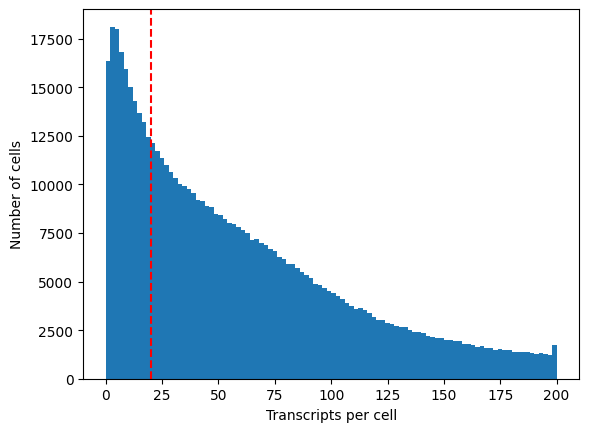

In [ ]:
fig = plt.hist(adata.obs["total_counts"], range=(0, 200), bins=100)
plt.axvline(x=20, color="r", linestyle="--")  # You can customize color and linestyle

plt.xlabel("Transcripts per cell")
plt.ylabel("Number of cells")

In [ ]:
# Based on the histogram plot, here we choose 20 transcript counts as lower cutoff
thres = np.quantile(adata.obs["total_counts"], 0.98)
sc.pp.filter_cells(adata, min_counts=20)
sc.pp.filter_cells(adata, max_counts=thres)

# We also filter out genes that are rarely expressed
sc.pp.filter_genes(adata, min_cells=100)

Next, we find top 2k variable genes in this Xenium Prime data. If you are analyzing Xenium v1 panel data, it's impossible to have top 2k variable genes. In that case, you can use all genes in the panel.

The following code is for Xenium Prime data (>5k genes). Here, we used Seurat's highly variable methodology, but there are other [highly variable genes flavours](https://scanpy.readthedocs.io/en/stable/generated/scanpy.pp.highly_variable_genes.html)

In [ ]:
%%time
sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=2000)

CPU times: user 14.5 s, sys: 168 ms, total: 14.7 s
Wall time: 5.75 s


We proceed with the usual single cell workflow. We first log-normalized the data, and store the log-normalized data in a layer called "lognorm". The "lognorm" data is important for downstream analysis as a lot of the functions work with log-normalized data. Alternatively, you can store it such as `adata.raw = adata.copy()`.

In [ ]:
%%time
# Log Normalization
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.layers["lognorm"] = adata.X.copy()

CPU times: user 5.17 s, sys: 0 ns, total: 5.17 s
Wall time: 2.9 s


In [ ]:
%%time
# Scaling of data, we don't center the data here as the data centering is done in PCA and this keeps the X sparse for memory efficiency.
sc.pp.scale(adata, zero_center=False, max_value=10)

CPU times: user 6.3 s, sys: 0 ns, total: 6.3 s
Wall time: 1.71 s


In [ ]:
%%time
# PCA for dimension reduction further by UMAP for downstream analysis
sc.pp.pca(adata, n_comps=30)
sc.pp.neighbors(adata, metric="cosine")
# clustering with leiden. We use igraph here as it scales better. The resolution is a hyper-parameter. A higher resolution will output more clusters.
sc.tl.leiden(adata, flavor="igraph", n_iterations=-1, resolution=0.5)

CPU times: user 3min 24s, sys: 2.33 s, total: 3min 26s
Wall time: 3min 19s


###Run UMAP

The following step to run UMAP will take > 20 mins in Google Colab.

In [ ]:
%%time
############### SKIP these steps for in-person events ###################
sc.tl.umap(adata)

CPU times: user 1h 15min 23s, sys: 13.7 ms, total: 1h 15min 23s
Wall time: 24min 29s


### Load processed data if you skip the above step
Uncomment this code if you did not run the UMAP in the previous step


In [ ]:
# !wget https://cf.10xgenomics.com/supp/xenium/analysis-workshop/breast_processed.zarr.zip
# !unzip breast_processed.zarr.zip

In [ ]:
## read pre-processed data
# sdata = sd.read_zarr("breast_processed.zarr")
# adata = sdata['table']

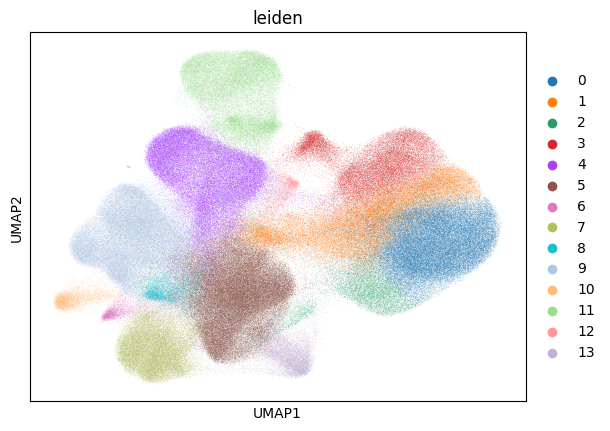

In [ ]:
sc.pl.umap(adata, color="leiden")

### Section 2.5.3 Plot clustering results spatially in slide

INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                


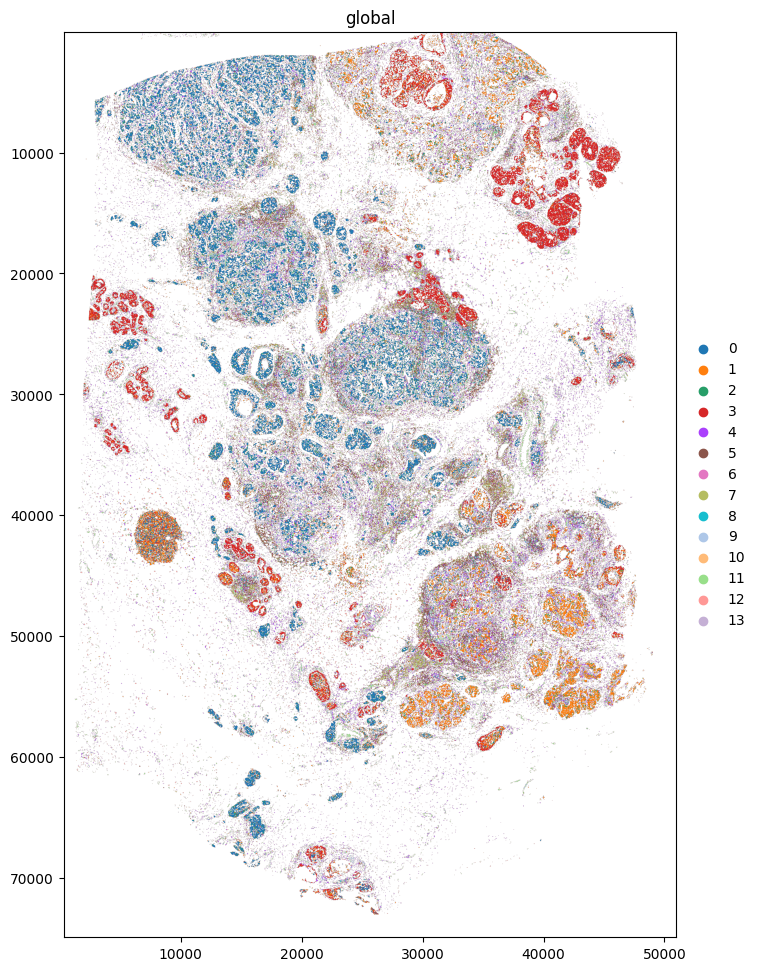

In [ ]:
sdata.tables["table"].obs["region"] = "cell_boundaries"
sdata.set_table_annotates_spatialelement("table", region="cell_boundaries")

sdata.pl.render_shapes("cell_boundaries", color="leiden").pl.show(figsize=(12.8, 9.6))

### Section 2.5.4 Export clustering results and visualize in Xenium Explorer

Save clustering results in a CSV file. The CSV file has two columns - `cell_id` and `group`. Below is one example:
```
cell_id	group
aaaaaohf-1	0
aaaafefl-1	2
aaaahjao-1	0
aaaajdej-1	0
aaaakcik-1	0
```



In [ ]:
clustering_res = adata.obs[["cell_id", "leiden"]]
clustering_res.columns = ["cell_id", "group"]
clustering_res.head()

,cell_id,group
0,aaaaaohf-1,0
2,aaaafefl-1,2
4,aaaahjao-1,0
5,aaaajdej-1,0
6,aaaakcik-1,0


In [ ]:
clustering_res.to_csv("clustering_res.csv", index=False)

Follow the instructions below on how to upload the `clustering_res.csv` into Xenium Explorer

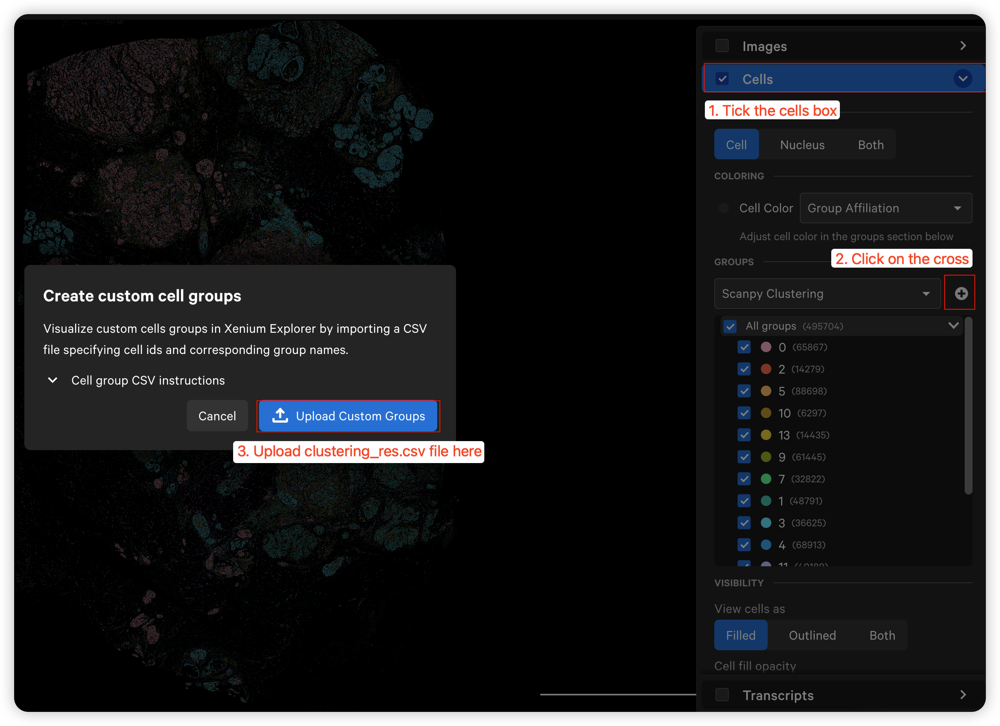

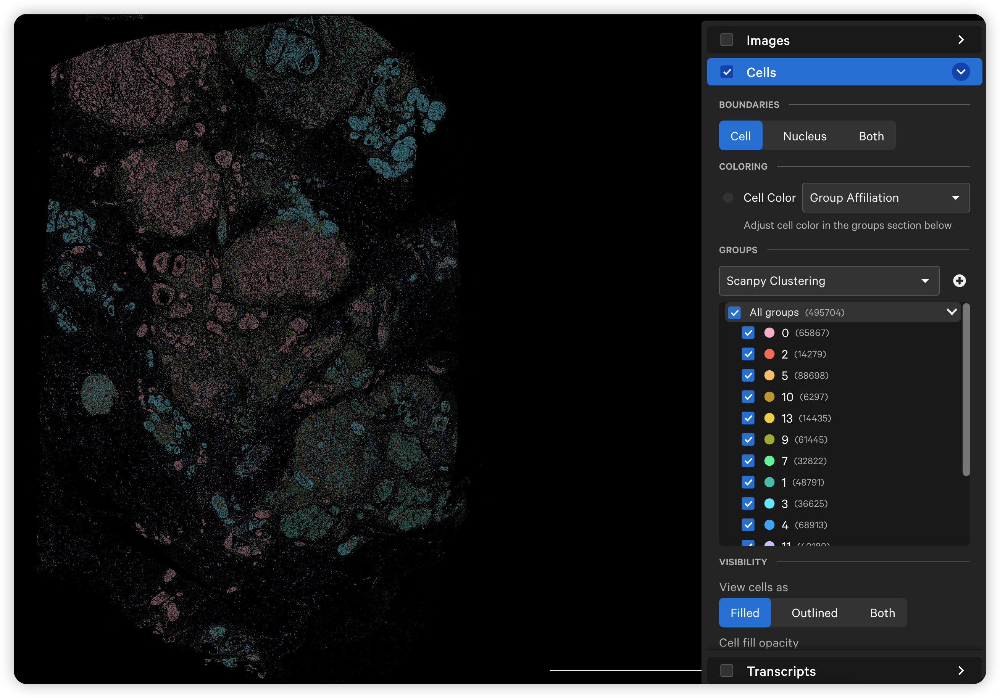

### Section 2.5.5 Find marker genes for each cluster for cell annotation

Use Scanpy's function `sc.tl.tl_genes_group` to identify marker genes in each cluster. By setting `pts=True`, it returns the percentage of cells that expresses each gene. In Scanpy, the functions are very flexible, and is up to the user to provide the right data. For `sc.tl.rank_gene_groups`, it expects log-normalized data, therefore we set the layer = "lognorm" here.

In [ ]:
sc.tl.rank_genes_groups(adata, groupby="leiden", layer="lognorm", pts=True)

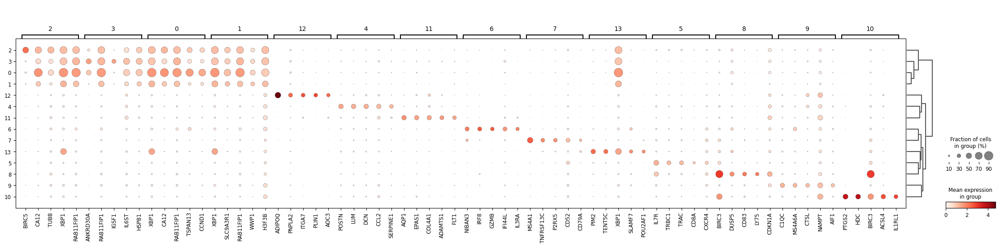

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5)

### Section 2.5.6 Cell annotation based on marker genes in each cluster

Based on marker genes in each cluster, we can identify each cell type.

Here we are sharing one possible way to annotate each cluster.

Step 1. Get marker genes in each cluster.

Step 2. Find cell type that is highly associated with the provided marker genes via third-party tools, such as [Enrichr](https://maayanlab.cloud/Enrichr/).

Step 3. Check spatial location of that cluster in Xenium Explorer (together with H&E image if any) and confirm its cell identity (some clusters' cell identities can be further supported by their spatial locations, such as tumor, vascular endothelial, etc).


**Making "endothelial" (cluster 11) as an example below:**

In [ ]:
endothelial_markers = sc.get.rank_genes_groups_df(adata, group="11")
endothelial_markers.head(10)

,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference
0,AQP1,128.825012,5.666183,0.0,0.0,0.377417,0.012573
1,EPAS1,120.762833,4.093678,0.0,0.0,0.366468,0.031485
2,COL4A1,120.348213,3.925318,0.0,0.0,0.361890,0.033094
3,ADAMTS1,115.333458,5.717781,0.0,0.0,0.321854,0.011266
4,FLT1,107.294380,4.484786,0.0,0.0,0.297246,0.022671
5,PLPP3,103.532036,2.953333,0.0,0.0,0.331807,0.057267
6,PLVAP,98.331360,5.683191,0.0,0.0,0.246585,0.006544
7,COL4A2,91.168404,3.623478,0.0,0.0,0.247953,0.023863
8,SOCS3,87.908150,2.034503,0.0,0.0,0.330812,0.095916
9,SLCO2A1,86.387924,5.736325,0.0,0.0,0.203215,0.006206


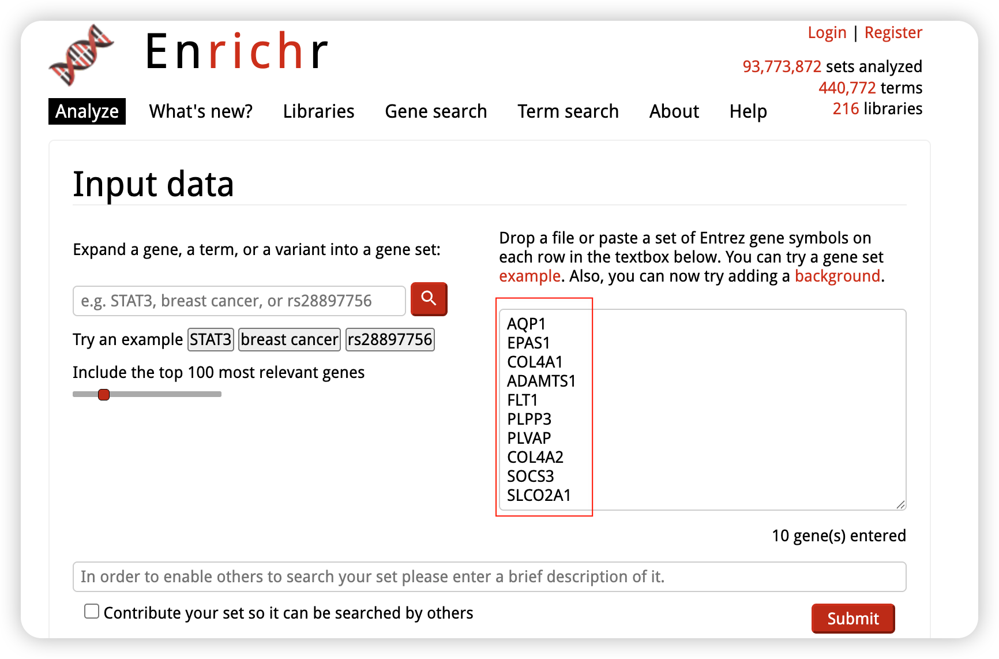

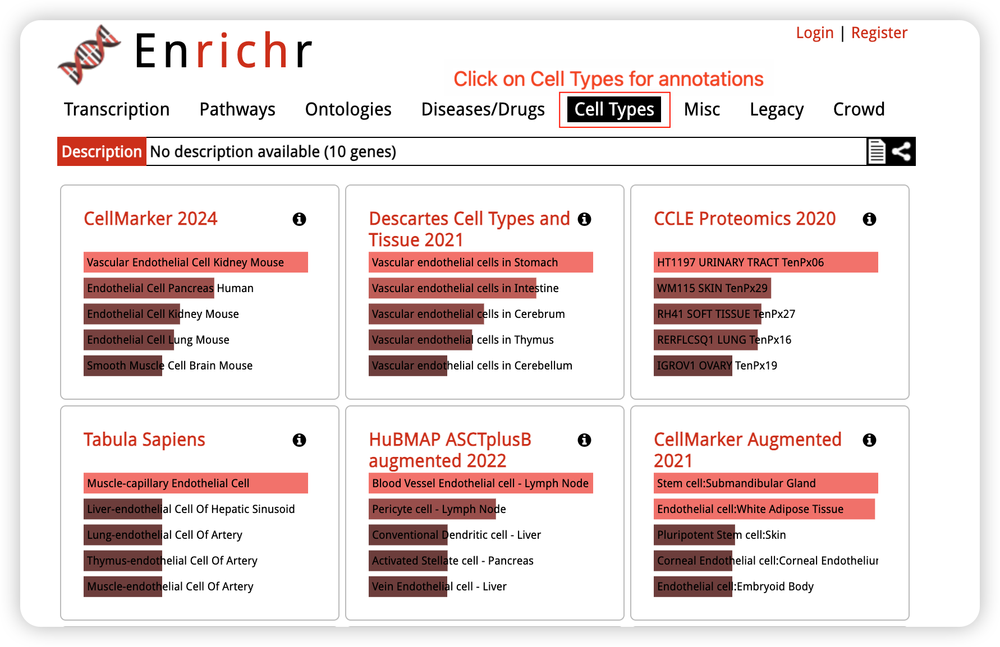

### Section 2.5.7 Saving the processed data
We can save the zarr format for further processing.

In [ ]:
sdata.write("breast_processed.zarr", overwrite=True)

INFO     The SpatialData object is not self-contained (i.e. it contains some elements that are Dask-backed from    
         locations outside breast_processed.zarr). Please see the documentation of `is_self_contained()` to        
         understand the implications of working with SpatialData objects that are not self-contained.              
INFO     The Zarr backing store has been changed from breast.zarr the new file path: breast_processed.zarr         


# **3. Xenium Prime multi-sample integration using sketch and Harmony**

Here, we are using two Xenium Prime datasets generated from the same Xenium gene panel. We recommend integration of Xenium data generated from the same gene panel. The integration of Xenium data generated from different Xenium gene panels is not recommended, since gene probe sets and codewords differ between gene panels.


The two Xenium datasets used in this sections are:
1.   [Human breast cancer Xenium Prime data](https://www.10xgenomics.com/datasets/xenium-prime-ffpe-human-breast-cancer)
2.   [Human cervical cancer Xenium Prime data](https://www.10xgenomics.com/datasets/xenium-prime-ffpe-human-cervical-cancer)

The analysis goal of the integration between breast and cervical cancer Xenium Prime data is to identify whether macrophages in these two cancer types could potentially have different functional roles.

Xenium data can be large. These two datasets (breast and cervical cancer) have in total more than 1.5 million cells. Currently, the on-disk (out-of-core) preprocessing pipeline for python is still experimental. Users who are interested in on-disk preprocessing can refer to [scanpy's dask tutorial](https://scanpy.readthedocs.io/en/stable/tutorials/experimental/dask.html) on how to do on-disk preprocessing. However, many of scanpy's functions are still not currently supported in dask.

To manage memory in this section, we keep the main `matrix(adata.X)` sparse to be memory efficient.



## Section 3.1 Downloading breast and cervical Xenium Prime data


Here we will need `cell_feature_matrix.h5` from both breast and cervical Xenium Prime outputs. We are downloading these two files for demo. This file can be easily found in Xenium output bundle.

1.   Human breast cancer Xenium Prime: `./human_breast_xenium/cell_feature_matrix.h5`
2.   Human cervical cancer Xenium Prime: `./human_cervical_xenium/cell_feature_matrix.h5`

In [ ]:
! wget https://cf.10xgenomics.com/supp/xenium/analysis-workshop/multi-sample-analysis.tar.gz
! tar -xzvf ./multi-sample-analysis.tar.gz

--2025-07-22 10:12:17--  https://cf.10xgenomics.com/supp/xenium/analysis-workshop/multi-sample-analysis.tar.gz
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 181630430 (173M) [application/x-tar]
Saving to: ‘multi-sample-analysis.tar.gz’

multi-sample-analys 100%[===================>] 173.22M   290MB/s    in 0.6s    

2025-07-22 10:12:18 (290 MB/s) - ‘multi-sample-analysis.tar.gz’ saved [181630430/181630430]

./multi-sample-analysis/
./multi-sample-analysis/human_breast_xenium/
./multi-sample-analysis/human_breast_xenium/cell_feature_matrix.h5
./multi-sample-analysis/human_breast_xenium/features.tsv.gz
./multi-sample-analysis/human_cervical_xenium/
./multi-sample-analysis/human_cervical_xenium/cell_feature_matrix.h5
./multi-sample-analysis/human_cervical_xenium/features.tsv.gz
./multi-sample

In [ ]:
adata_breast = sc.read_10x_h5(
    "./multi-sample-analysis/human_breast_xenium/cell_feature_matrix.h5"
)
adata_cervical = sc.read_10x_h5(
    "./multi-sample-analysis/human_cervical_xenium/cell_feature_matrix.h5"
)

Since there are multiple samples in this demo, it's a good practice to make cell IDs unique across all integrated samples. Here, we add suffix to cell IDs. For example, we add "_breast" suffix to each cell ID in breast cancer data and "_cervical" suffix to each cell ID in cervical cancer data.

In [ ]:
adata_breast.obs_names = adata_breast.obs_names + "_breast"
adata_cervical.obs_names = adata_cervical.obs_names + "_cervical"
adata_breast.obs["tissue"] = "breast"
adata_cervical.obs["tissue"] = "cervical"

## Section 3.2 Conventional data processing by processing in memory

For this section, we will first combine the breast and cervical Xenium dataset, followed by the same preprocessing done in Section 2.


In [ ]:
adata = ad.concat([adata_breast, adata_cervical])

In [ ]:
# Running this will crash the runtime if adata is in dask as of current scanpy==1.2
%%time
sc.pp.calculate_qc_metrics(adata, inplace=True, log1p=True)

CPU times: user 1min 16s, sys: 628 ms, total: 1min 17s
Wall time: 42.8 s


The preprocessing follows the exact steps in Section 2. The first step is QC. We want to remove cells with low transcript counts. Here we plot the distribution of transcript counts per cell in a histogram to decide the lower cutoff in transcript counts (aiming to remove cells with low transcript counts). The determination of lower cutoff can be subjective. There is no gold-standard rule.  

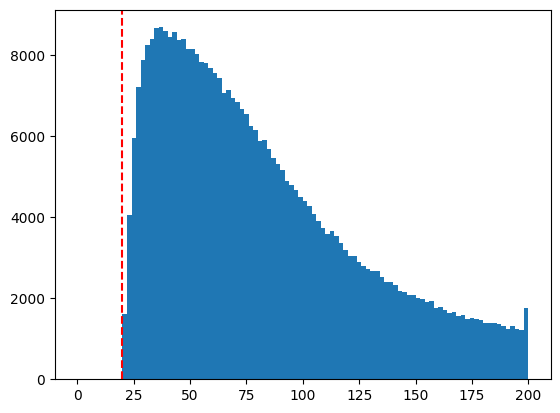

In [ ]:
fig = plt.hist(adata.obs["total_counts"], range=(0, 200), bins=100)
plt.axvline(x=20, color="r", linestyle="--")  # You can customize color and linestyle

In [ ]:
%%time
thres = np.quantile(adata.obs["total_counts"], 0.98)
sc.pp.filter_cells(adata, min_counts=20)
sc.pp.filter_cells(adata, max_counts=thres)

sc.pp.filter_genes(adata, min_cells=100)

CPU times: user 3.29 s, sys: 12.9 ms, total: 3.3 s
Wall time: 3.28 s


In [ ]:
# Again, we store the counts layer in the anndata object
adata.layers["counts"] = adata.X.copy()

In [ ]:
%%time
sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=2000, layer="counts")

CPU times: user 12.1 s, sys: 9.48 ms, total: 12.1 s
Wall time: 4.04 s


In [ ]:
%%time
sc.pp.normalize_total(adata)
sc.pp.log1p(adata)
adata.layers["lognorm"] = adata.X.copy()

CPU times: user 4.6 s, sys: 4.89 ms, total: 4.61 s
Wall time: 1.48 s


In [ ]:
%%time
sc.pp.scale(adata, zero_center=False, max_value=10)
sc.pp.pca(adata, n_comps=30)
# Use this function is you are using the dask function
# adata.obsm["X_pca"] = adata.obsm["X_pca"].compute()

CPU times: user 51.9 s, sys: 59.7 ms, total: 52 s
Wall time: 21.9 s


## Section 3.3 Sketching of data for faster visualization (Optional)
Sketching downsamples the data while aiming to retain the rarer cell types. We use this sketched data to generate a downsampled UMAP later for a quicker visualization. This is unlike Seurat's sketch analysis in R, where the downstream analysis is done on the sketched data. You can choose to skip this step to generate the UMAP on the original dataset.

In [ ]:
%%time
import geosketch as gs

N = 50000  # Number of samples to obtain from the data set.
sketch_index = gs.gs(adata.obsm["X_pca"], N, replace=False)

CPU times: user 3min 35s, sys: 2.23 s, total: 3min 37s
Wall time: 3min 36s


## Section 3.4 Batch correction with Harmony

Before doing batch correction, we can check if there are significant batch effects between these two data: project cells in 2D UMAP space without any batch correction and visualize cells by their sample origins. If most of cell types are very well separated between samples in UMAP space, it could indicate batch effects.

In [ ]:
%%time
adata_sketch = adata[sketch_index]
sc.pp.neighbors(adata_sketch, metric="cosine")
sc.tl.umap(adata_sketch)

CPU times: user 3min 43s, sys: 62.8 ms, total: 3min 43s
Wall time: 1min 29s


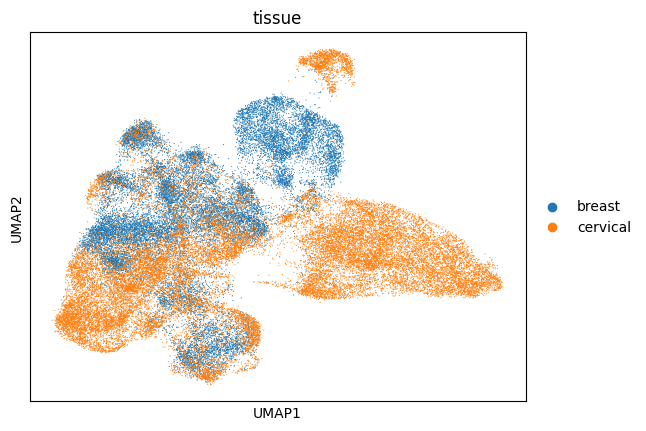

In [ ]:
sc.pl.umap(adata_sketch, color="tissue")

If there are significant batch effects, we can use Harmony to correct batch effects. In this demo, we continue doing batch correction using Harmony. Harmony will correct `PCA` space (which contains variations from batch effects). After removing batch effects, Harmony will generate new corrected reduced-dimension results. It is labeled as `X_pca_harmony` and accessed via `adata.obsm["X_pca_harmony"]`.

In [ ]:
%%time
############### SKIP these steps for in-person events ###################
# Please note that the harmony is ran on the original data and not the sketched data
sc.external.pp.harmony_integrate(adata, key="tissue")

2025-07-22 10:18:51,124 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
INFO:harmonypy:Computing initial centroids with sklearn.KMeans...
2025-07-22 10:24:20,746 - harmonypy - INFO - sklearn.KMeans initialization complete.
INFO:harmonypy:sklearn.KMeans initialization complete.
2025-07-22 10:24:27,425 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2025-07-22 10:46:20,157 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2025-07-22 11:06:29,576 - harmonypy - INFO - Converged after 2 iterations
INFO:harmonypy:Converged after 2 iterations


CPU times: user 1h 41min 51s, sys: 11.6 s, total: 1h 42min 3s
Wall time: 47min 39s


### Load processed data if you skip the above step
Uncomment this code if you did not run the Harmony in the previous step


In [ ]:
# !wget https://cf.10xgenomics.com/supp/xenium/analysis-workshop/breast_cervical_adata.h5ad

In [ ]:
# adata = sc.read_h5ad("breast_cervical_adata.h5ad")

In [ ]:
%%time
adata_sketch = adata[sketch_index]
sc.pp.neighbors(adata_sketch, use_rep="X_pca_harmony", metric="cosine")
sc.tl.umap(adata_sketch)

CPU times: user 3min 35s, sys: 220 ms, total: 3min 35s
Wall time: 1min 24s


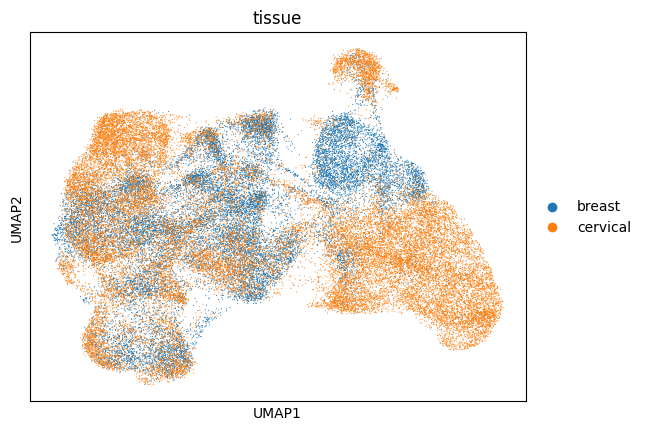

In [ ]:
sc.pl.umap(adata_sketch, color="tissue")

In [ ]:
%%time
sc.pp.neighbors(adata, use_rep="X_pca_harmony", metric="cosine")
sc.tl.leiden(adata, flavor="igraph", n_iterations=-1, resolution=1.2)

CPU times: user 9min 40s, sys: 4.07 s, total: 9min 45s
Wall time: 9min 34s


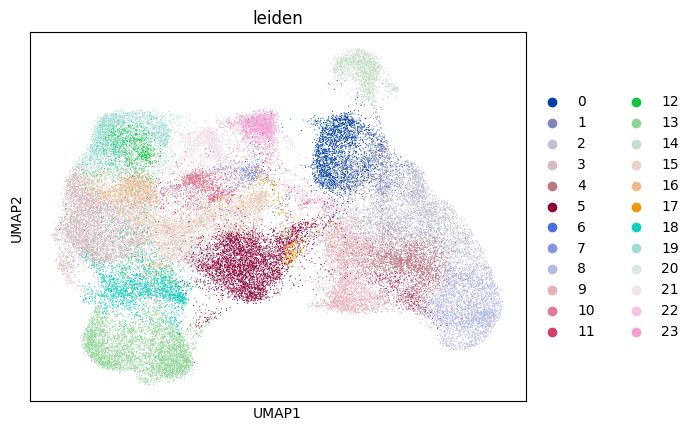

In [ ]:
# We assign the cluster labels from the full dataset to the sketched adata object for plotting
adata_sketch.obs["leiden"] = adata.obs["leiden"]
sc.pl.umap(adata_sketch, color="leiden")

## Section 3.5 Export all cell clustering results in CSV and import to Xenium Explorer

After batch correction, we can export batch corrected clustering results in CSV files for both breast cancer and cervical cancer data separately. We can import each sample's clustering results (generated by integrative analysis) into its own Xenium Explorer interface.

In [ ]:
clusters_breast = adata[adata.obs.tissue == "breast"].obs.copy()
clusters_breast["cell_id"] = (
    clusters_breast.index.str.split("-").str[0]
    + "-"
    + clusters_breast.index.str.split("-").str[1]
)
clusters_breast["group"] = clusters_breast["leiden"]
clusters_breast.loc[:, ["cell_id", "group"]].to_csv("clusters_breast.csv", index=False)

In [ ]:
clusters_cervical = adata[adata.obs.tissue == "cervical"].obs.copy()
clusters_cervical["cell_id"] = (
    clusters_cervical.index.str.split("-").str[0]
    + "-"
    + clusters_cervical.index.str.split("-").str[1]
)
clusters_cervical["group"] = clusters_cervical["leiden"]
clusters_cervical.loc[:, ["cell_id", "group"]].to_csv(
    "clusters_cervical.csv", index=False
)

We can follow Session 2.5.4 to import `clustering_breast.csv` file into Xenium Explorer

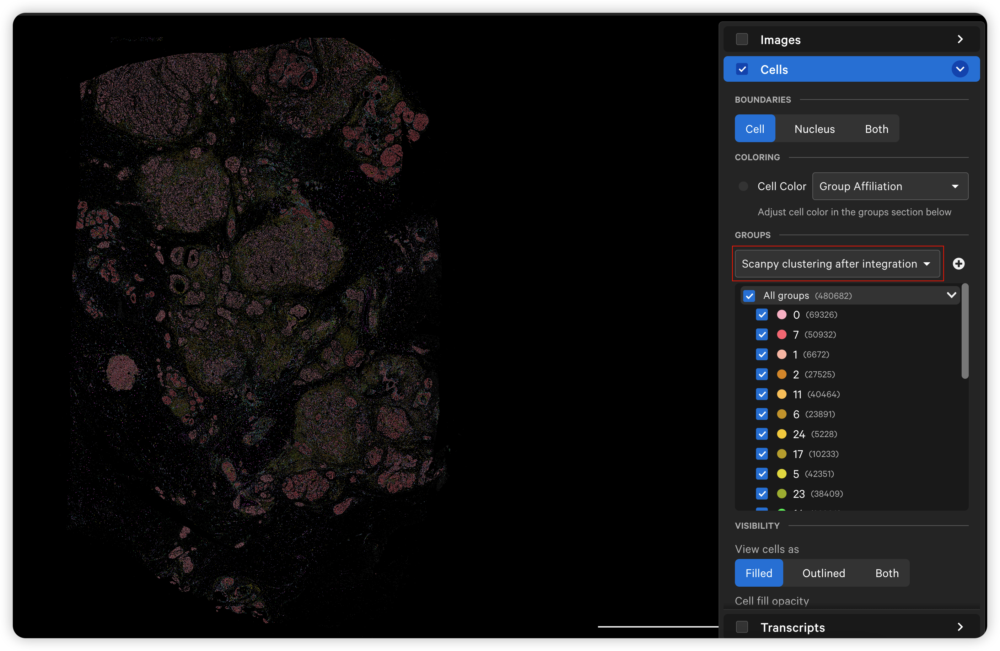

## Section 3.6 Find cluster marker genes for cell annotation

We can compute marker genes in each cluster and accordingly annotate each cluster.




In [ ]:
%%time
sc.tl.rank_genes_groups(adata, groupby="leiden", layer="lognorm", pts=True)

CPU times: user 3min 36s, sys: 2.01 ms, total: 3min 36s
Wall time: 1min


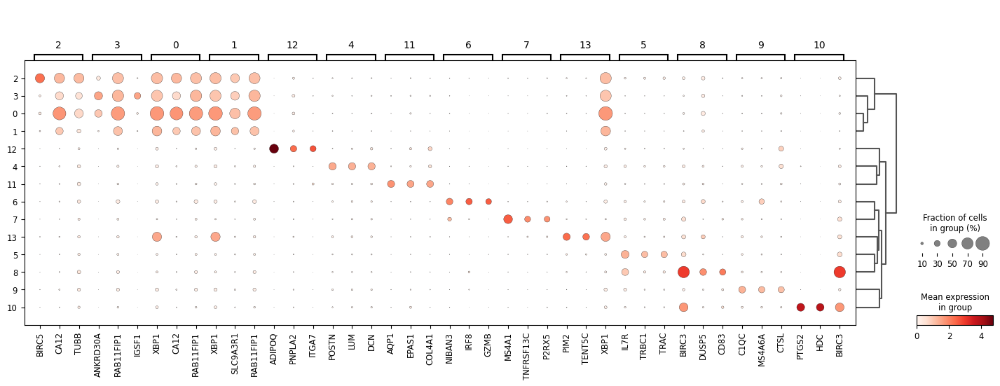

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=3)

## Section 3.7 Subset for macrophages

Below we subset macrophages only and compare gene expression in macrophages between breast cancer and cervical cancer data. The demonstration below is for explorative purposes to compare macrophages between two tissues. The p-values obtained from this analysis should be interpreted with caution, because these tests treat each bin as an independent replicate, which could cause false positives.

**A more robust statistic test for differential expression genes (DEG) between conditions requires biological replicates (at least 3 biological replicates per condition are recommended) and pseudo-bulk DEG analysis approach can be used for this analysis.** See more documentation below:

*   [Differential Gene Expression Analysis in scRNA-seq Data between Conditions with Biological Replicates](https://www.10xgenomics.com/analysis-guides/differential-gene-expression-analysis-in-scrna-seq-data-between-conditions-with-biological-replicates)
*   [Use PyDESeq2 for pseudo-bulk DE analysis](https://pydeseq2.readthedocs.io/en/stable/auto_examples/plot_step_by_step.html#sphx-glr-auto-examples-plot-step-by-step-py)


In [ ]:
adata_macrophages = adata[adata.obs.leiden == "5"]

Re-do analyses: Find variable genes, data normalization and scaling, PCA, Harmony batch correction (on PCA), UMAP and clustering on macrophage cells only.

In [ ]:
%%time
adata_macrophages.X = adata_macrophages.layers["counts"].copy()
sc.pp.highly_variable_genes(adata_macrophages, n_top_genes=2000, flavor="seurat_v3")
sc.pp.normalize_total(adata_macrophages)
sc.pp.log1p(adata_macrophages)

adata_macrophages.layers["lognorm"] = adata_macrophages.X.copy()

sc.pp.scale(adata_macrophages, zero_center=False, max_value=10)
sc.pp.pca(adata_macrophages, n_comps=30)

sc.external.pp.harmony_integrate(adata_macrophages, key="tissue")
sc.pp.neighbors(adata_macrophages, use_rep="X_pca_harmony")
sc.tl.umap(adata_macrophages)

2025-07-22 11:18:59,366 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
INFO:harmonypy:Computing initial centroids with sklearn.KMeans...
2025-07-22 11:21:18,202 - harmonypy - INFO - sklearn.KMeans initialization complete.
INFO:harmonypy:sklearn.KMeans initialization complete.
2025-07-22 11:21:19,112 - harmonypy - INFO - Iteration 1 of 10
INFO:harmonypy:Iteration 1 of 10
2025-07-22 11:22:34,892 - harmonypy - INFO - Iteration 2 of 10
INFO:harmonypy:Iteration 2 of 10
2025-07-22 11:23:49,988 - harmonypy - INFO - Converged after 2 iterations
INFO:harmonypy:Converged after 2 iterations


CPU times: user 30min 12s, sys: 3.08 s, total: 30min 15s
Wall time: 9min 20s


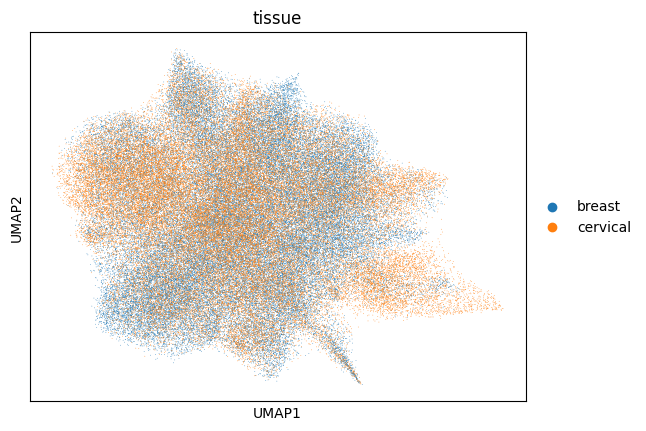

In [ ]:
sc.pl.umap(adata_macrophages, color=["tissue"], vmax="p99")

Compute DEG in macrophages between breast cancer and cervical cancer data.

In [ ]:
sc.tl.rank_genes_groups(adata_macrophages, groupby="tissue", layer="lognorm", pts=True)

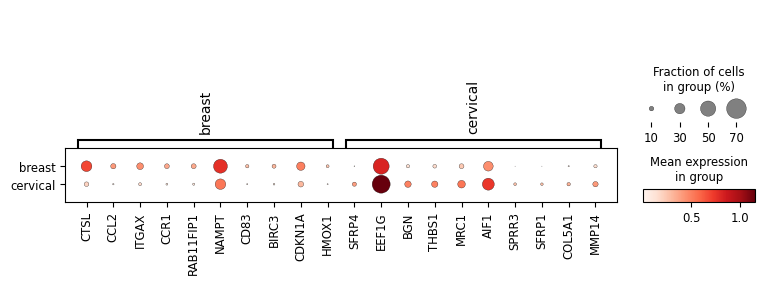

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata_macrophages)

Based on DEG results, _CTSL_ is significantly higher expressed in breast cancer macrophages compared to cervical cancer.

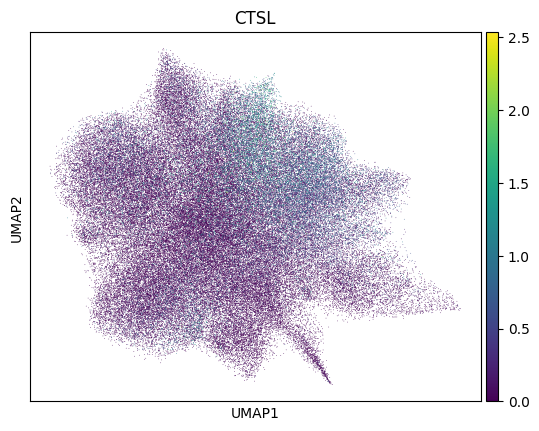

In [ ]:
sc.pl.umap(adata_macrophages, color="CTSL", layer="lognorm")

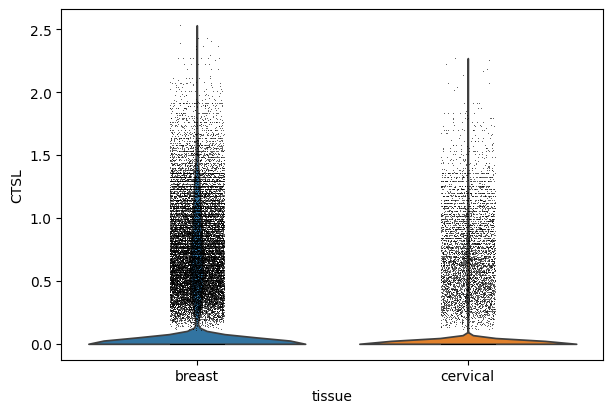

In [ ]:
sc.pl.violin(
    adata_macrophages, groupby="tissue", keys="CTSL", layer="lognorm", size=0.5
)

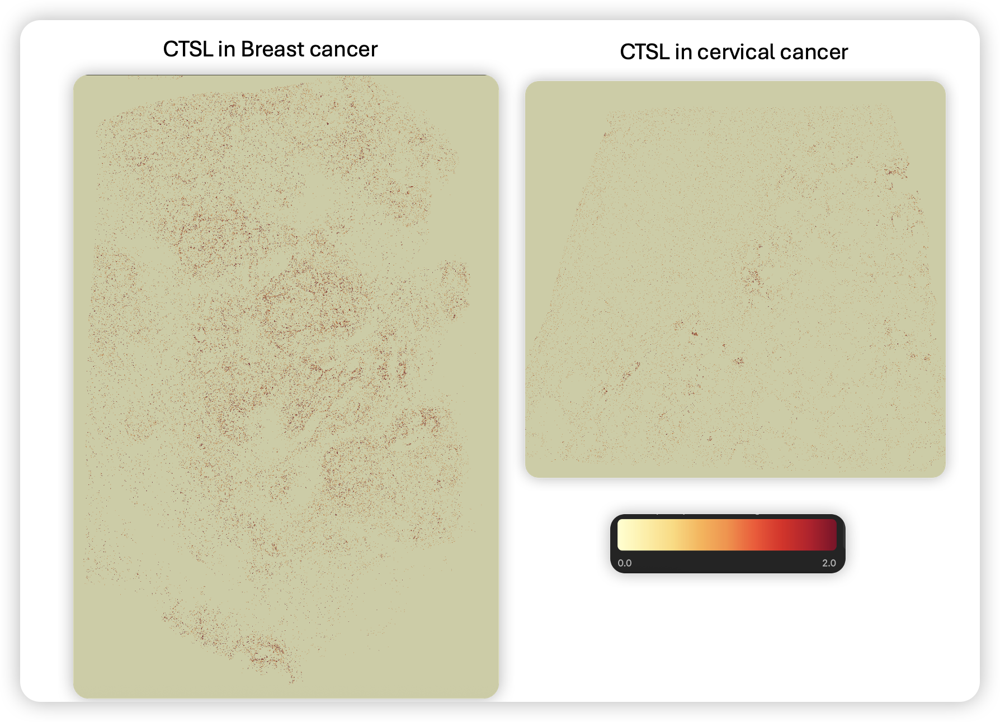

Higher expression of _CTSL_ in macrophages is reported to be associated with tumor progression and poor prognosis ([Zhang, et al., 2024](https://www.sciencedirect.com/science/article/pii/S2405844024053040), [Alderton, 2010](https://www.nature.com/articles/nrc2816), [Xiao, et al., 2024](https://www.wjgnet.com/1007-9327/full/v30/i47/5032.htm)). Our analysis of the tutorial data shows higher expression of _CTSL_ in breast cancer tissue macrophages, suggesting more of a pro-tumor role of macrophages in breast cancer compared to cervical cancer.

# **4. [Additional Topics] Neighbors enrichment analysis**

Here, we return to the Xenium Breast Cancer results in Section 2 to show a simple neighborhood enrichment analysis. Although, we did not annotate the cell types in the following section, we would recommend first annotating cell types in your own analysis.

In [ ]:
import squidpy as sq
import anndata as ad
import matplotlib.pyplot as plt

In [ ]:
# Read breast_processed zarr file that is saved in Section 2
sdata = sd.read_zarr("breast_processed.zarr")
adata = sdata["table"]

### Section 4.1  Building a spatial neighborhood graph

#### 4.1.1 Compute centrality scores

We calculate the centrality scores for each cell or spot using the clustering labels provided in `adata.obs["leiden"]`. Centrality measures how "important" a cluster is within the graph, providing an overall picture of which clusters might be important.

- **Average clustering** - Measures the tendency of nodes within the cluster to form triangles. High values suggest tight-knit groups, often found in localized tissue regions or co-expressing gene modules.

- **Closeness centrality** - How close a cluster is, on average, to all other clusters in the graph. A cluster with high closeness may act as a mediator or integrator, potentially central in tissue structure or cell–cell communication.

- **Degree centrality** - The fraction of edges from group members that connect to non-group members. High inter-group degree centrality indicates outward-facing influence. These clusters may be key in interacting with other cell types or regions.

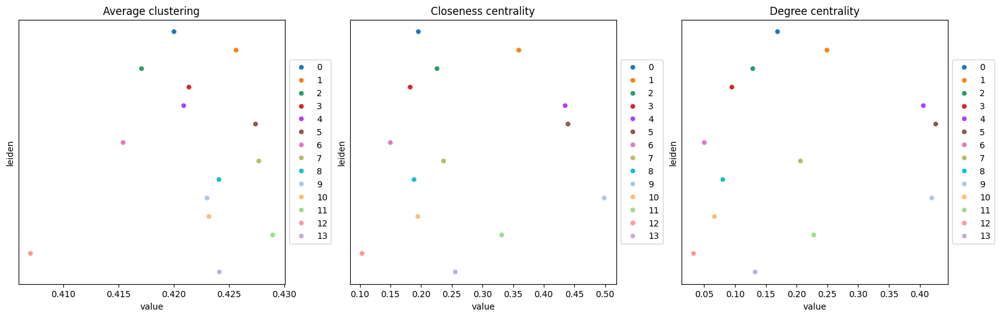

In [ ]:
sq.gr.spatial_neighbors(adata, coord_type="generic", delaunay=True)
# Compute centrality scores
sq.gr.centrality_scores(adata, cluster_key="leiden")
sq.pl.centrality_scores(adata, cluster_key="leiden", figsize=(16, 5))

## Section 4.2 Neighbors enrichment analysis

Neighborhood enrichment analysis calculates an enrichment score by assessing the proximity of cell clusters on the connectivity graph. This score is then compared to a distribution generated through permutations, and a z-score is calculated based on the observed versus expected number of events.

Below, cluster 3 shows the highest self-enrichment, meaning it is most frequently found near itself.

In [ ]:
sq.gr.nhood_enrichment(adata, cluster_key="leiden")

  0%|          | 0/1000 [00:00<?, ?/s]

INFO     Using 'datashader' backend with 'None' as reduction method to speed up plotting. Depending on the         
         reduction method, the value range of the plot might change. Set method to 'matplotlib' do disable this    
         behaviour.                                                                                                


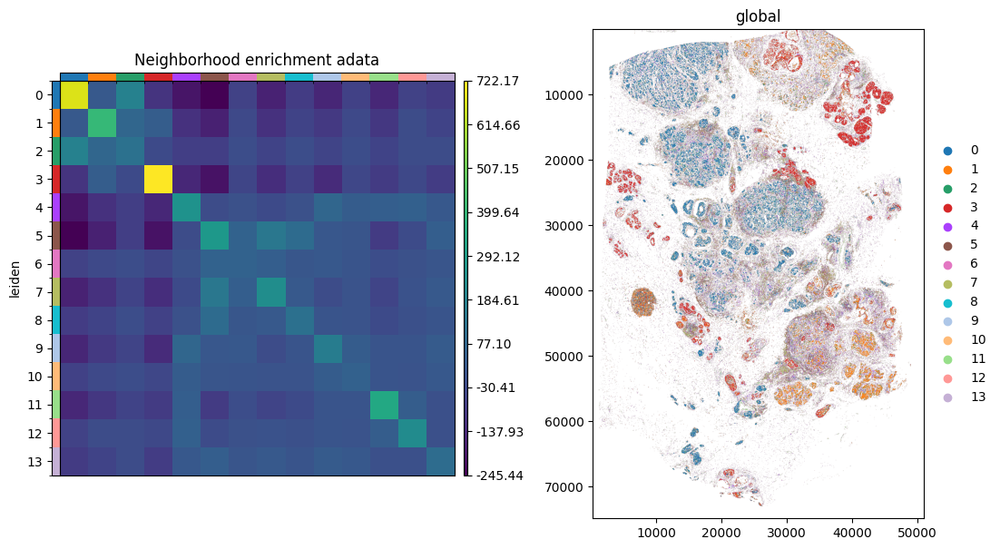

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(13, 7))
sq.pl.nhood_enrichment(
    adata,
    cluster_key="leiden",
    figsize=(8, 8),
    title="Neighborhood enrichment adata",
    ax=ax[0],
)
sdata.pl.render_shapes("cell_boundaries", color="leiden").pl.show(ax=ax[1])

## Section 4.3 Identify Spatially Variable genes/features (SVF) by Moran's I score

A gene with the highest Moran's I score in a spatial transcriptomics dataset is a prime example of a spatially variable gene that exhibits strong, non-random, and clustered expression. This makes it a valuable candidate for understanding tissue organization, identifying spatial domains, and inferring biological functions linked to specific locations within the tissue.

In [ ]:
%%time
sq.gr.spatial_autocorr(
    adata,
    mode="moran",
    n_jobs=-1,
)
adata.uns["moranI"].head(10)

CPU times: user 3min 33s, sys: 3.79 s, total: 3min 37s
Wall time: 58.6 s


,I,pval_norm,var_norm,pval_norm_fdr_bh
XBP1,0.397333,0.0,6.835433e-07,0.0
CA12,0.375674,0.0,6.835433e-07,0.0
RAB11FIP1,0.375518,0.0,6.835433e-07,0.0
TSPAN13,0.299253,0.0,6.835433e-07,0.0
IGSF1,0.298321,0.0,6.835433e-07,0.0
ANKRD30A,0.274479,0.0,6.835433e-07,0.0
TCIM,0.270507,0.0,6.835433e-07,0.0
SERPINA3,0.256498,0.0,6.835433e-07,0.0
MYH11,0.251630,0.0,6.835433e-07,0.0
NPY1R,0.236942,0.0,6.835433e-07,0.0


We can visualize some of those genes with `squidpy.pl.spatial_scatter`.

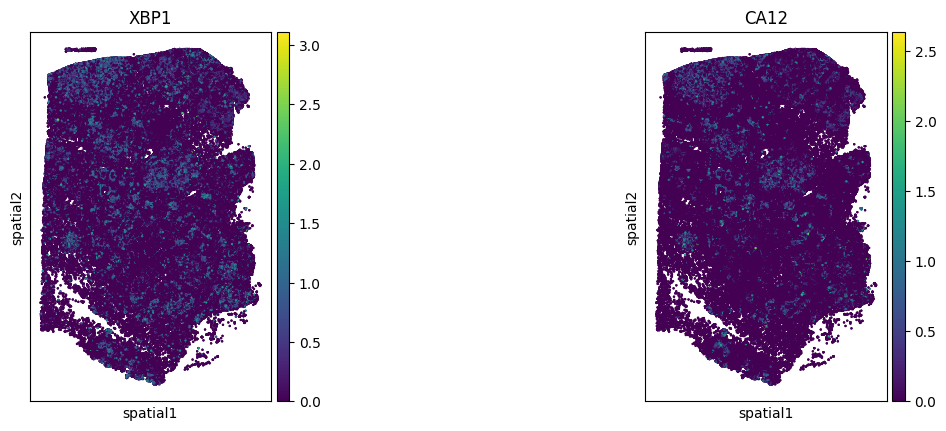

In [ ]:
# We can also use squidpy's plotting to plot out the genes
sq.pl.spatial_scatter(
    adata,
    library_id="spatial",
    color=["XBP1", "CA12"],
    shape=None,
    size=2,
    img=False,
    layer="lognorm",
)

View those genes in Xenium Explorer:

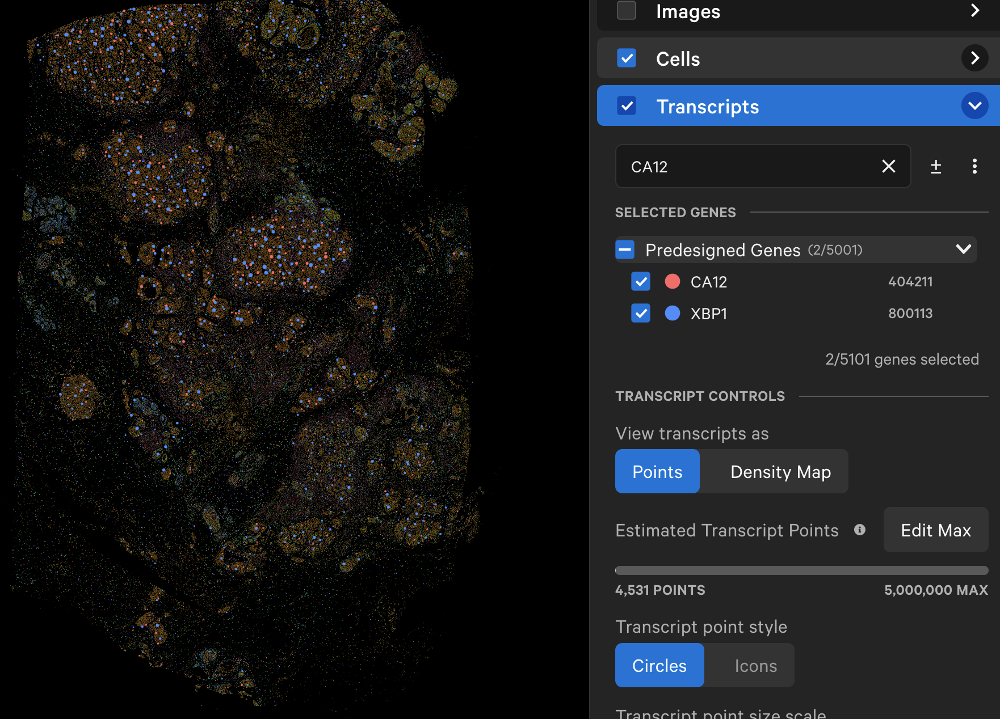

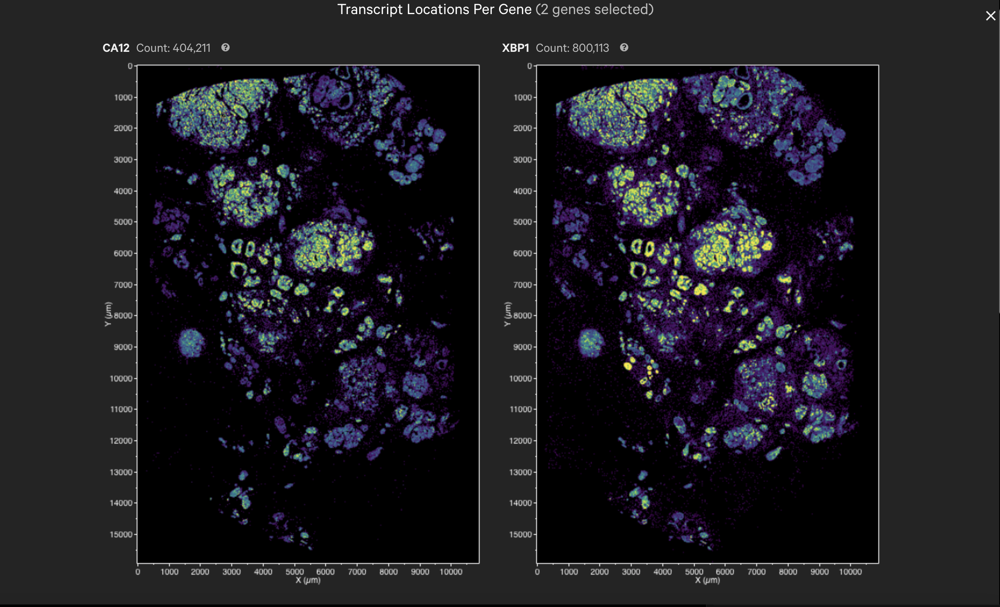

_XBP1_ is not a marker for all types of breast cancer, it is a crucial factor, particularly in certain subtypes like ER-positive and triple-negative breast cancer (TNBC). https://www.cell.com/heliyon/fulltext/S2405-8440(20)32060-0 https://pmc.ncbi.nlm.nih.gov/articles/PMC7557884/